In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from scipy.stats import f_oneway
import math
import matplotlib.pyplot as plt

In [2]:
df = pd.read_csv('all_normalized.csv', index_col='Unnamed: 0')

In [3]:
brain_df = df[df['tissue'] == 'brain']
lung_df = df[df['tissue'] == 'lung']
panc_df = df[df['tissue'] == 'pancreas']

In [4]:
brain_df = brain_df.drop(columns=['tissue']);
lung_df = lung_df.drop(columns=['tissue']);
panc_df = panc_df.drop(columns=['tissue']);

In [5]:
genes = list(df.columns)[:-1]
len(genes)

60660

In [6]:
genes[-1]

'ENSG00000288675.1'

In [7]:
brain_group = list(brain_df[genes[0]].values)
lung_group = list(lung_df[genes[0]].values)
panc_group = list(panc_df[genes[0]].values)

#perform one-way ANOVA
res = f_oneway(brain_group, lung_group, panc_group)

print(res)

F_onewayResult(statistic=18.910234203340785, pvalue=9.424305770488717e-09)


In [8]:
anova_results = dict()

In [171]:
for i in range(len(genes)):
#     print(i)
    brain_group = list(brain_df[genes[i]].values)
    lung_group = list(lung_df[genes[i]].values)
    panc_group = list(panc_df[genes[i]].values)
    
    res = f_oneway(brain_group, lung_group, panc_group)
    anova_results[genes[i]] = res

/Users/jonathanlifferth/opt/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:3650: F_onewayConstantInputWarning:

Each of the input arrays is constant;the F statistic is not defined or infinite



In [173]:
# anova_results

In [11]:
len(anova_results)

60660

In [12]:
res_vals = list(anova_results.values())

In [13]:
res_vals[0][0]

18.910234203340785

In [14]:
p_vals = [i[1] for i in res_vals]
f_stats = [i[0] for i in res_vals]

In [174]:
p_vals[:10]

[9.424305770488717e-09,
 0.8261705087984033,
 1.9310631788575716e-12,
 6.114396856377262e-10,
 5.017027563196016e-07,
 1.811544318735208e-41,
 7.98071223389849e-22,
 5.086840136909777e-13,
 5.2283868191418985e-05,
 1.0490701816959947e-18]

<AxesSubplot:>

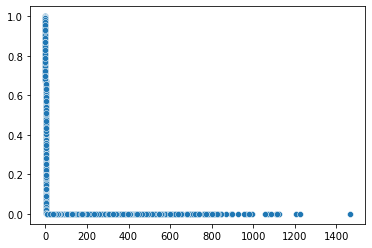

In [16]:
sns.scatterplot(x=f_stats, y=p_vals)

<AxesSubplot:>

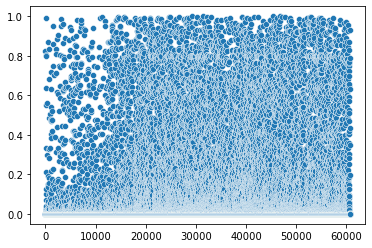

In [17]:
sns.scatterplot(x=np.arange(0, len(p_vals), 1), y=p_vals)

In [18]:
low_p_vals = list(filter(lambda p: p < 1e-100, p_vals))

In [19]:
len(low_p_vals)

498

In [175]:
# np.sort(low_p_vals)

In [21]:
import math

In [22]:
log2_p_vals = [-(math.log10(p)) for p in low_p_vals]

In [176]:
log2_p_vals[:10]

[121.93297759859877,
 117.52086133116481,
 145.56342693600405,
 108.14851213721718,
 227.06503831037173,
 106.67260736479287,
 102.0469691541955,
 106.49018822556633,
 109.18066782958218,
 179.62183798873264]

Text(0.5, 1.0, '500 lowest p-values from ANOVA')

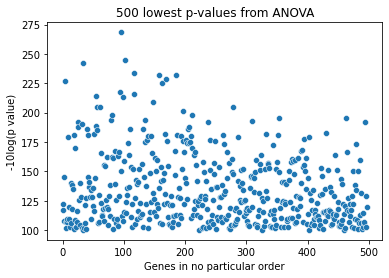

In [24]:
sns.scatterplot(x=np.arange(0, len(log2_p_vals), 1), y=log2_p_vals)
plt.ylabel('-10log(p value)')
plt.xlabel('Genes in no particular order')
plt.title('500 lowest p-values from ANOVA')

In [25]:
all_log2_p_vals = [-(math.log10(p)) for p in p_vals]

Text(0.5, 1.0, 'p-values from ANOVA')

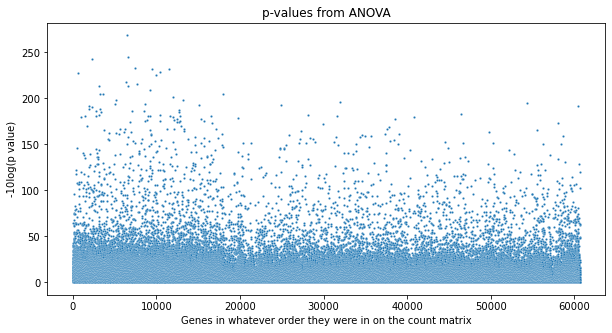

In [26]:
plt.figure(figsize=(10,5))
sns.scatterplot(x=np.arange(0, len(all_log2_p_vals), 1), y=all_log2_p_vals, s=5)
plt.ylabel('-10log(p value)')
plt.xlabel('Genes in whatever order they were in on the count matrix')
plt.title('p-values from ANOVA')

In [47]:
# okay now we're going to try to include chromosome and base pair location

chrom_df = pd.read_csv('/Users/jonathanlifferth/data/Vanderbilt/bsci_5272/mart_export(1).txt', sep='\t')

/Users/jonathanlifferth/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3251: DtypeWarning: Columns (4) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [48]:
chrom_df

,Gene stable ID,Gene stable ID version,Transcript stable ID,Transcript stable ID version,Chromosome/scaffold name,Gene start (bp),Gene end (bp),Gene name,Source of gene name
0,ENSG00000210049,ENSG00000210049.1,ENST00000387314,ENST00000387314.1,MT,577,647,MT-TF,HGNC Symbol
1,ENSG00000211459,ENSG00000211459.2,ENST00000389680,ENST00000389680.2,MT,648,1601,MT-RNR1,HGNC Symbol
2,ENSG00000210077,ENSG00000210077.1,ENST00000387342,ENST00000387342.1,MT,1602,1670,MT-TV,HGNC Symbol
3,ENSG00000210082,ENSG00000210082.2,ENST00000387347,ENST00000387347.2,MT,1671,3229,MT-RNR2,HGNC Symbol
4,ENSG00000209082,ENSG00000209082.1,ENST00000386347,ENST00000386347.1,MT,3230,3304,MT-TL1,HGNC Symbol
...,...,...,...,...,...,...,...,...,...
274573,ENSG00000284882,ENSG00000284882.2,ENST00000646567,ENST00000646567.2,1,84574114,84583620,NaN,NaN
274574,ENSG00000284882,ENSG00000284882.2,ENST00000644618,ENST00000644618.1,1,84574114,84583620,NaN,NaN
274575,ENSG00000289881,ENSG00000289881.1,ENST00000701339,ENST00000701339.1,1,84614068,84621061,NaN,NaN
274576,ENSG00000289881,ENSG00000289881.1,ENST00000701824,ENST00000701824.1,1,84614068,84621061,NaN,NaN


In [49]:
chrom_df = chrom_df[chrom_df['Gene stable ID version'].isin(genes)]

In [50]:
chrom_df

,Gene stable ID,Gene stable ID version,Transcript stable ID,Transcript stable ID version,Chromosome/scaffold name,Gene start (bp),Gene end (bp),Gene name,Source of gene name
0,ENSG00000210049,ENSG00000210049.1,ENST00000387314,ENST00000387314.1,MT,577,647,MT-TF,HGNC Symbol
1,ENSG00000211459,ENSG00000211459.2,ENST00000389680,ENST00000389680.2,MT,648,1601,MT-RNR1,HGNC Symbol
2,ENSG00000210077,ENSG00000210077.1,ENST00000387342,ENST00000387342.1,MT,1602,1670,MT-TV,HGNC Symbol
3,ENSG00000210082,ENSG00000210082.2,ENST00000387347,ENST00000387347.2,MT,1671,3229,MT-RNR2,HGNC Symbol
4,ENSG00000209082,ENSG00000209082.1,ENST00000386347,ENST00000386347.1,MT,3230,3304,MT-TL1,HGNC Symbol
...,...,...,...,...,...,...,...,...,...
274556,ENSG00000206764,ENSG00000206764.1,ENST00000384037,ENST00000384037.1,1,182327068,182327174,RNU6-152P,HGNC Symbol
274557,ENSG00000228664,ENSG00000228664.1,ENST00000451731,ENST00000451731.1,1,182328497,182329007,NaN,NaN
274558,ENSG00000231684,ENSG00000231684.3,ENST00000423841,ENST00000423841.1,1,182336001,182336334,EIF1P3,HGNC Symbol
274559,ENSG00000264470,ENSG00000264470.1,ENST00000582305,ENST00000582305.1,1,64579847,64579923,MIR4794,HGNC Symbol


In [30]:
chrom_df.loc[chrom_df['Gene stable ID version'].isin(genes)]

,Gene stable ID,Gene stable ID version,Transcript stable ID,Transcript stable ID version,Chromosome/scaffold name,Gene start (bp),Gene end (bp),Gene name,Source of gene name


In [51]:
chrom_df.loc[chrom_df['Gene stable ID version'].isin(genes)]['Chromosome/scaffold name'].unique()

array(['MT', 'Y', '18', '22', '20', '14', '21', '8', '5', '11', 'X', '10',
       '2', '19', '7', '4', '1', '13', '12', '9', '6', '15', '3', '16',
       '17', 7, 15, 3, 11, 4, 2, 1, 12, 19, 16, 5, 10, 17, 9, 6],
      dtype=object)

In [52]:
chrom_df[chrom_df['Gene stable ID version'] == genes[0]].iloc[0]

Gene stable ID                     ENSG00000000003
Gene stable ID version          ENSG00000000003.15
Transcript stable ID               ENST00000373020
Transcript stable ID version     ENST00000373020.9
Chromosome/scaffold name                         X
Gene start (bp)                          100627108
Gene end (bp)                            100639991
Gene name                                   TSPAN6
Source of gene name                    HGNC Symbol
Name: 68385, dtype: object

In [53]:
chrom_df.index = chrom_df['Gene stable ID version']

In [54]:
chrom_df = chrom_df[['Chromosome/scaffold name', 'Gene start (bp)', 'Gene name']]

In [55]:
chrom_df

,Chromosome/scaffold name,Gene start (bp),Gene name
Gene stable ID version,,,
ENSG00000210049.1,MT,577,MT-TF
ENSG00000211459.2,MT,648,MT-RNR1
ENSG00000210077.1,MT,1602,MT-TV
ENSG00000210082.2,MT,1671,MT-RNR2
ENSG00000209082.1,MT,3230,MT-TL1
...,...,...,...
ENSG00000206764.1,1,182327068,RNU6-152P
ENSG00000228664.1,1,182328497,NaN
ENSG00000231684.3,1,182336001,EIF1P3


In [56]:
anova_results_df = pd.DataFrame.from_dict(anova_results, orient='index')

In [57]:
# this df now has the anova results, and chromosome/position data

anova_chrom_df = pd.merge(chrom_df, anova_results_df, left_index=True, right_index=True)

In [58]:
anova_chrom_df = anova_chrom_df.dropna()

In [59]:
len(anova_chrom_df)

142391

In [60]:
anova_chrom_df = anova_chrom_df.drop_duplicates()

In [61]:
anova_chrom_df

,Chromosome/scaffold name,Gene start (bp),Gene name,statistic,pvalue
ENSG00000000003.15,X,100627108,TSPAN6,18.910234,9.424306e-09
ENSG00000000005.6,X,100584936,TNMD,0.190999,8.261705e-01
ENSG00000000457.14,1,169849631,SCYL3,21.783552,6.114397e-10
ENSG00000000460.17,1,169662007,C1orf112,14.769464,5.017028e-07
ENSG00000000938.13,1,27612064,FGR,105.629680,1.811544e-41
...,...,...,...,...,...
ENSG00000288616.1,18,46962768,ELOA3DP,39.417906,4.648975e-17
ENSG00000288622.1,5,271670,PDCD6-AHRR,6.216330,2.093592e-03
ENSG00000288631.1,18,47028202,ELOA3P,26.160762,9.819075e-12
ENSG00000288638.1,6,166167920,LNCDAT,6.740038,1.250395e-03


In [62]:
anova_chrom_df = anova_chrom_df.astype({'Chromosome/scaffold name':'str'})

In [63]:
anova_chrom_df = anova_chrom_df.sort_values('Chromosome/scaffold name')
anova_chrom_df

,Chromosome/scaffold name,Gene start (bp),Gene name,statistic,pvalue
ENSG00000206704.1,1,28985710,Y_RNA,30.170504,2.314229e-13
ENSG00000206659.1,1,175022479,Y_RNA,0.703980,4.949169e-01
ENSG00000206654.1,1,39120940,RNU6-608P,56.570841,1.023034e-23
ENSG00000206652.1,1,16514122,RNU1-1,27.988804,1.770681e-12
ENSG00000206651.1,1,156484098,Y_RNA,20.510240,2.050102e-09
...,...,...,...,...,...
ENSG00000224482.1,Y,20808776,HSFY4P,3.291763,3.768882e-02
ENSG00000129845.5,Y,9753156,TTTY1,5.170894,5.869408e-03
ENSG00000224408.1,Y,9183694,USP9YP22,17.826730,2.656420e-08
ENSG00000232226.2,Y,12252321,ARSFP1,9.127322,1.203031e-04


In [65]:
all_log2_p_vals = [-(math.log10(p)) for p in list(anova_chrom_df['pvalue'])] 

Text(0.5, 1.0, 'ANOVA p-values')

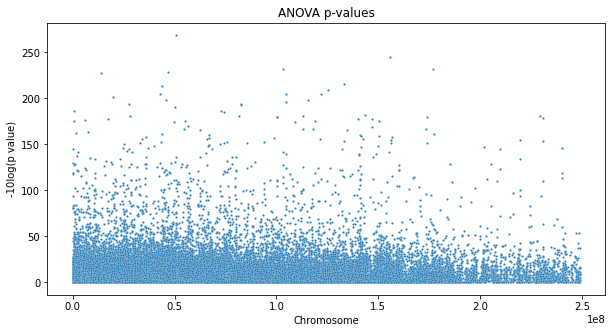

In [66]:
plt.figure(figsize=(10,5))
sns.scatterplot(x=anova_chrom_df['Gene start (bp)'], y=all_log2_p_vals, s=5)
plt.ylabel('-10log(p value)')
plt.xlabel('Chromosome')

plt.title('ANOVA p-values')

In [67]:
anova_chrom_df['Chromosome/scaffold name'].unique()

array(['1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19',
       '2', '20', '21', '22', '3', '4', '5', '6', '7', '8', '9', 'MT',
       'X', 'Y'], dtype=object)

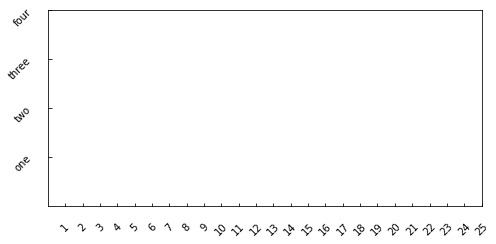

In [68]:
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True
x = [1, 2, 3, 4]
labels = [1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13,
            14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25]
ax1 = plt.subplot()
ax1.set_xticks(labels)
ax1.set_yticks(x)
ax1.set_xticklabels(labels, rotation=45)
ax1.set_yticklabels(["one", "two", "three", "four"], rotation=45)
ax1.tick_params(axis="both", direction="in", pad=15)
plt.show()

In [177]:
# # import libraries
# from pandas import DataFrame
# from scipy.stats import uniform
# from scipy.stats import randint
# import numpy as np
# import matplotlib.pyplot as plt

# # sample data
# df = DataFrame({'gene' : ['gene-%i' % i for i in np.arange(10000)],
# 'pvalue' : uniform.rvs(size=10000),
# 'chromosome' : ['ch-%i' % i for i in randint.rvs(0,12,size=10000)]})

# # -log_10(pvalue)
# df['minuslog10pvalue'] = -np.log10(df.pvalue)
# df.chromosome = df.chromosome.astype('category')
# df.chromosome = df.chromosome.cat.set_categories(['ch-%i' % i for i in range(12)], ordered=True)
# df = df.sort_values('chromosome')

# # How to plot gene vs. -log10(pvalue) and colour it by chromosome?
# df['ind'] = range(len(df))
# df_grouped = df.groupby(('chromosome'))

# # manhattan plot
# fig = plt.figure(figsize=(14, 8)) # Set the figure size
# ax = fig.add_subplot(111)
# colors = ['darkred','darkgreen','darkblue', 'gold']
# x_labels = []
# x_labels_pos = []
# for num, (name, group) in enumerate(df_grouped):
#     group.plot(kind='scatter', x='ind', y='minuslog10pvalue',color=colors[num % len(colors)], ax=ax)
#     x_labels.append(name)
#     x_labels_pos.append((group['ind'].iloc[-1] - (group['ind'].iloc[-1] - group['ind'].iloc[0])/2))
# ax.set_xticks(x_labels_pos)
# ax.set_xticklabels(x_labels)

# # set axis limits
# ax.set_xlim([0, len(df)])
# ax.set_ylim([0, 3.5])

# # x axis label
# ax.set_xlabel('Chromosome')

# # show the graph
# plt.show()

In [70]:
x_labels_pos

[408.0,
 1223.0,
 2043.5,
 2875.5,
 3704.0,
 4534.0,
 5381.0,
 6233.5,
 7081.5,
 7924.5,
 8765.5,
 9593.0]

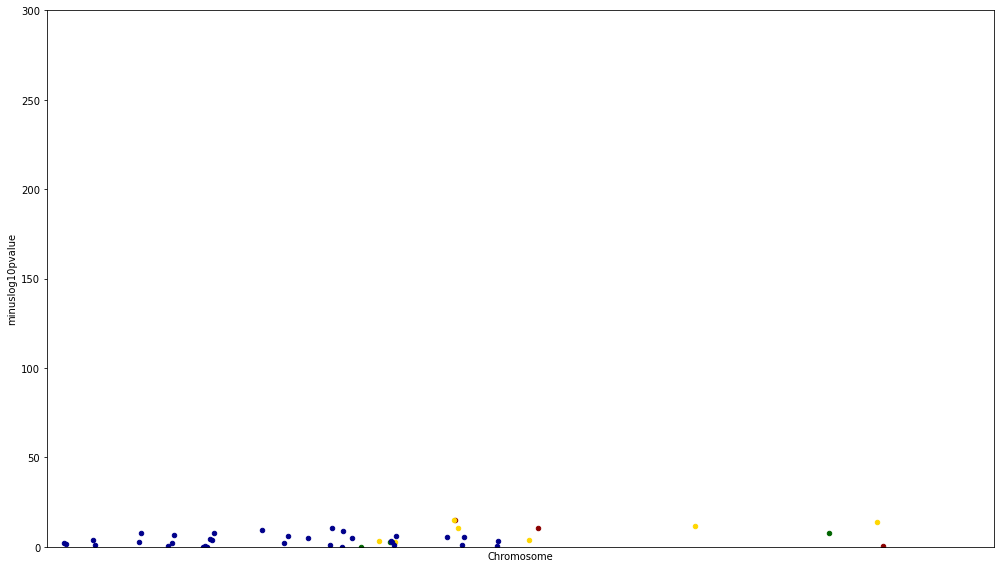

In [71]:
# now let's try that with...
# real data
mpl_df = DataFrame({'gene' : anova_chrom_df['Gene name'],
                    'pvalue' : anova_chrom_df['pvalue'],
                    'chromosome' : anova_chrom_df['Chromosome/scaffold name'],
                   'ind': anova_chrom_df['Gene start (bp)']})

# -log_10(pvalue)
mpl_df['minuslog10pvalue'] = -np.log10(mpl_df.pvalue)
# mpl_df.chromosome = mpl_df.chromosome.astype('category')
# mpl_df.chromosome = mpl_df.chromosome.cat.set_categories(['ch-%i' % i for i in range(26)], ordered=True)
mpl_df = mpl_df.sort_values('chromosome')

# How to plot gene vs. -log10(pvalue) and colour it by chromosome?
mpl_df_grouped = mpl_df.groupby(('chromosome'))

# manhattan plot
fig = plt.figure(figsize=(14, 8)) # Set the figure size
ax = fig.add_subplot(111)
colors = ['darkred','darkgreen','darkblue', 'gold']
mpl_x_labels = []
mpl_x_labels_pos = []
for num, (name, group) in enumerate(mpl_df_grouped):
    group.plot(kind='scatter', x='ind', y='minuslog10pvalue',color=colors[num % len(colors)], ax=ax)
    x_labels.append(name)
    x_labels_pos.append((group['ind'].iloc[-1] - (group['ind'].iloc[-1] - group['ind'].iloc[0])/2))
ax.set_xticks(mpl_x_labels_pos)
ax.set_xticklabels(mpl_x_labels)

# set axis limits
ax.set_xlim([0, len(mpl_df)])
ax.set_ylim([0, 300])

# x axis label
ax.set_xlabel('Chromosome')

# show the graph
plt.show()

In [72]:
mpl_df['chromosome'].unique()

array(['1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19',
       '2', '20', '21', '22', '3', '4', '5', '6', '7', '8', '9', 'MT',
       'X', 'Y'], dtype=object)

In [73]:
mpl_df.sort_values('ind')['chromosome'].unique()

array(['MT', '18', '3', '9', '12', '16', '1', '2', '10', '4', '19', '17',
       '11', '20', '6', '7', '5', '8', 'X', 'Y', '21', '22', '13', '14',
       '15'], dtype=object)

In [74]:
len(mpl_df_grouped)

25

In [178]:
# for num, (name, group) in enumerate(mpl_df_grouped):
#     print(num)
#     print(name)
#     print(group)

# A bunch of other stuff didn't work, but let's do an FDR correction and call it good

In [76]:
from statsmodels.stats.multitest import fdrcorrection

(array([28442.,  1108.,   760.,   593.,   511.,   488.,   522.,   402.,
          421.,   221.]),
 array([3.63478984e-269, 9.99728246e-002, 1.99945649e-001, 2.99918474e-001,
        3.99891298e-001, 4.99864123e-001, 5.99836947e-001, 6.99809772e-001,
        7.99782596e-001, 8.99755421e-001, 9.99728246e-001]),
 <BarContainer object of 10 artists>)

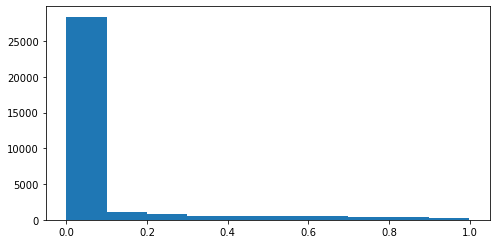

In [77]:
plt.hist(anova_chrom_df['pvalue'])

In [78]:
len(np.where(anova_chrom_df['pvalue'] < 0.05)[0])

27555

In [79]:
corrected_pvals = fdrcorrection(anova_chrom_df['pvalue'], method='n')

In [80]:
type(corrected_pvals)

tuple

In [179]:
# for i in corrected_pvals[1]:
#     print(i)

In [82]:
from collections import Counter

In [83]:
Counter(corrected_pvals[0])

Counter({True: 24847, False: 8621})

(array([25488.,   705.,   445.,   299.,   256.,   208.,   215.,   185.,
          138.,  5529.]),
 array([1.33760239e-263, 1.00000000e-001, 2.00000000e-001, 3.00000000e-001,
        4.00000000e-001, 5.00000000e-001, 6.00000000e-001, 7.00000000e-001,
        8.00000000e-001, 9.00000000e-001, 1.00000000e+000]),
 <BarContainer object of 10 artists>)

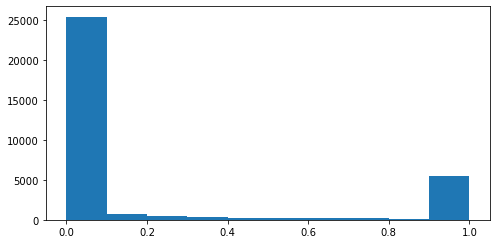

In [84]:
plt.hist(corrected_pvals[1])

In [85]:
corrected_log10_p_vals = [-(math.log10(p)) for p in corrected_pvals[1]] 

In [86]:
-(math.log10(.05))

1.3010299956639813

Text(0.5, 1.0, 'ANOVA p-values (FDR adjusted)')

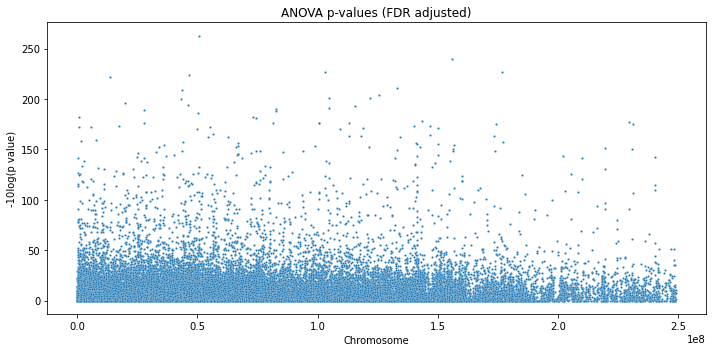

In [87]:
plt.figure(figsize=(10,5))
sns.scatterplot(x=anova_chrom_df['Gene start (bp)'], y=corrected_log10_p_vals, s=5)
plt.ylabel('-10log(p value)')
plt.xlabel('Chromosome')

plt.title('ANOVA p-values (FDR adjusted)')

# let's try a bonferroni correction??

In [88]:
from statsmodels.stats.multitest import multipletests

In [89]:
bonf = multipletests(anova_chrom_df['pvalue'], method='bonferroni')

In [90]:
Counter(bonf[0])

Counter({True: 19627, False: 13841})

In [146]:
sig_gene_vals = [bonf[1][i] for i in range(len(bonf[0])) if bonf[0][i] == True]

In [148]:
len(sig_gene_vals)

19627

(array([20015.,   418.,   242.,   199.,   135.,   112.,    92.,    97.,
           84., 12074.]),
 array([1.21649146e-264, 1.00000000e-001, 2.00000000e-001, 3.00000000e-001,
        4.00000000e-001, 5.00000000e-001, 6.00000000e-001, 7.00000000e-001,
        8.00000000e-001, 9.00000000e-001, 1.00000000e+000]),
 <BarContainer object of 10 artists>)

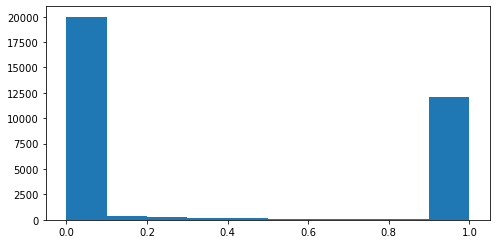

In [91]:
plt.hist(bonf[1])

In [92]:
bonf_log10_p_vals = [-(math.log10(p)) for p in list(bonf[1])]  

In [180]:
# # How to plot gene vs. -log10(pvalue) and colour it by chromosome?
# df['ind'] = range(len(df))
# df_grouped = df.groupby(('chromosome'))

# # manhattan plot
# fig = plt.figure(figsize=(14, 8)) # Set the figure size
# ax = fig.add_subplot(111)
# colors = ['darkred','darkgreen','darkblue', 'gold']
# x_labels = []
# x_labels_pos = []
# for num, (name, group) in enumerate(df_grouped):
#     group.plot(kind='scatter', x='ind', y='minuslog10pvalue',color=colors[num % len(colors)], ax=ax)
#     x_labels.append(name)
#     x_labels_pos.append((group['ind'].iloc[-1] - (group['ind'].iloc[-1] - group['ind'].iloc[0])/2))
# ax.set_xticks(x_labels_pos)
# ax.set_xticklabels(x_labels)

In [94]:
df

,gene,pvalue,chromosome,minuslog10pvalue,ind
2277,gene-2277,0.839282,ch-0,0.076092,0
8643,gene-8643,0.914201,ch-0,0.038958,1
6117,gene-6117,0.833166,ch-0,0.079269,2
3249,gene-3249,0.761855,ch-0,0.118128,3
3254,gene-3254,0.797502,ch-0,0.098268,4
...,...,...,...,...,...
2713,gene-2713,0.471572,ch-11,0.326452,9995
9179,gene-9179,0.961684,ch-11,0.016968,9996
9180,gene-9180,0.021913,ch-11,1.659306,9997
2717,gene-2717,0.682242,ch-11,0.166061,9998


In [95]:
anova_chrom_df['bonf'] = bonf_log10_p_vals

In [96]:
anova_chrom_df

,Chromosome/scaffold name,Gene start (bp),Gene name,statistic,pvalue,bonf
ENSG00000206704.1,1,28985710,Y_RNA,30.170504,2.314229e-13,8.110964
ENSG00000206659.1,1,175022479,Y_RNA,0.703980,4.949169e-01,-0.000000
ENSG00000206654.1,1,39120940,RNU6-608P,56.570841,1.023034e-23,18.465480
ENSG00000206652.1,1,16514122,RNU1-1,27.988804,1.770681e-12,7.227230
ENSG00000206651.1,1,156484098,Y_RNA,20.510240,2.050102e-09,4.163595
...,...,...,...,...,...,...
ENSG00000224482.1,Y,20808776,HSFY4P,3.291763,3.768882e-02,-0.000000
ENSG00000129845.5,Y,9753156,TTTY1,5.170894,5.869408e-03,-0.000000
ENSG00000224408.1,Y,9183694,USP9YP22,17.826730,2.656420e-08,3.051074
ENSG00000232226.2,Y,12252321,ARSFP1,9.127322,1.203031e-04,-0.000000


Text(0.5, 1.0, 'ANOVA p-values (Bonferroni corrected)')

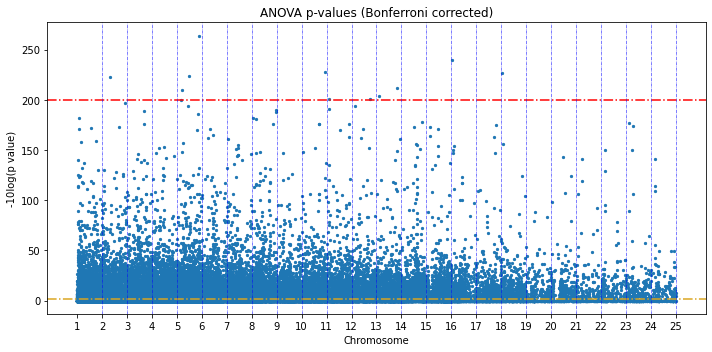

In [97]:
import matplotlib
x_labels = [1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13,
            14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25]
x_labels_pos = list(np.linspace(0, anova_chrom_df['Gene start (bp)'].max(), num=len(x_labels)))
v_divs = np.linspace(0, anova_chrom_df['Gene start (bp)'].max(), num=len(x_labels))[1:]

plt.rcParams["figure.figsize"] = [10.00, 5]
ax = plt.subplot()
# ax.figure(figsize=(10,5))
ax.scatter(x=anova_chrom_df['Gene start (bp)'], y=anova_chrom_df['bonf'], s=5)
ax.set_ylabel('-10log(p value)')
ax.set_xlabel('Chromosome')
ax.axhline(y=-(math.log10(.05)), color='goldenrod', linestyle='dashdot')
ax.axhline(y=200, color='red', linestyle='dashdot')

for divider in v_divs:
    ax.axvline(x=divider, color='blue', linestyle='dashdot', linewidth=.5)

ax.set_xticks(x_labels_pos)
ax.set_xticklabels(x_labels)

ax.set_title('ANOVA p-values (Bonferroni corrected)')

In [98]:
top_genes = anova_chrom_df[anova_chrom_df['bonf'] > 210]
top_genes

,Chromosome/scaffold name,Gene start (bp),Gene name,statistic,pvalue,bonf
ENSG00000152092.16,1,176857302,ASTN1,1110.981003,2.235641e-232,227.125968
ENSG00000132718.9,1,155859567,SYT11,1227.423466,2.403618e-245,240.094505
ENSG00000131409.13,19,50516892,LRRC4B,1465.134217,3.634790e-269,263.914891
ENSG00000160307.10,21,46598604,S100B,1084.229710,2.948345e-229,224.005792
ENSG00000138650.9,4,133149294,PCDH10,980.273815,1.418884e-216,211.323423
ENSG00000164929.17,8,103140713,BAALC,1115.368688,6.964762e-233,227.632464
ENSG00000046653.15,X,13770939,GPM6B,1071.829669,8.609178e-228,222.540409


In [99]:
for gene in top_genes['Gene name']:
    print(gene)
    print(top_genes[top_genes['Gene name'] == gene]['Gene start (bp)'].values)
    print(top_genes[top_genes['Gene name'] == gene]['bonf'].values)

ASTN1
[176857302]
[227.12596823]
SYT11
[155859567]
[240.09450482]
LRRC4B
[50516892]
[263.91489093]
S100B
[46598604]
[224.00579189]
PCDH10
[133149294]
[211.32342344]
BAALC
[103140713]
[227.63246398]
GPM6B
[13770939]
[222.54040855]


ASTN1
SYT11
LRRC4B
S100B
PCDH10
BAALC
GPM6B


Text(0.5, 1.0, 'ANOVA p-values (Bonferroni corrected)')

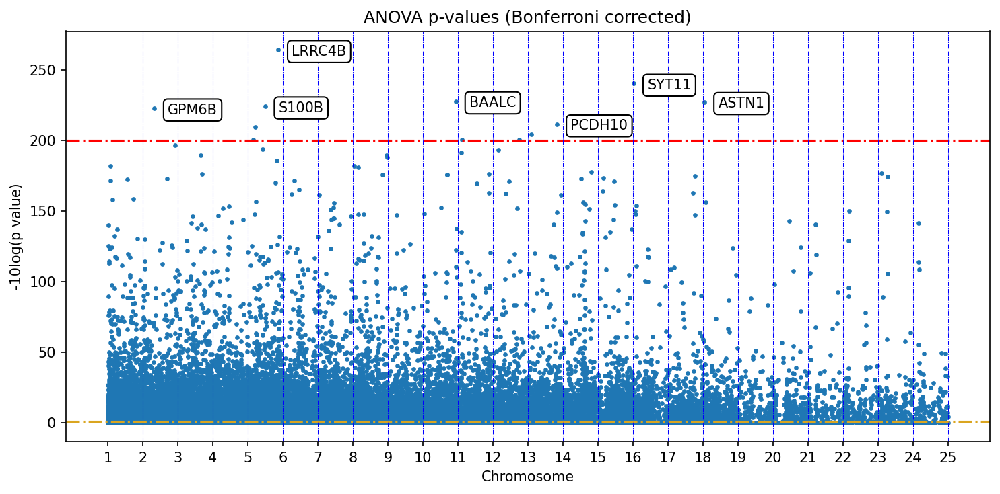

In [181]:
x_labels = [1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13,
            14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25]
x_labels_pos = list(np.linspace(0, anova_chrom_df['Gene start (bp)'].max(), num=len(x_labels)))
v_divs = np.linspace(0, anova_chrom_df['Gene start (bp)'].max(), num=len(x_labels))[1:]

plt.rcParams["figure.figsize"] = [10.00, 5]
# plt.rcParams["figure.dpi"] = 200

ax = plt.subplot()
# ax.figure(figsize=(10,5))
ax.scatter(x=anova_chrom_df['Gene start (bp)'], y=anova_chrom_df['bonf'], s=5)
ax.set_ylabel('-10log(p value)')
ax.set_xlabel('Chromosome')
ax.axhline(y=-(math.log10(.05)), color='goldenrod', linestyle='dashdot')
ax.axhline(y=200, color='red', linestyle='dashdot')

for divider in v_divs:
    ax.axvline(x=divider, color='blue', linestyle='dashdot', linewidth=.5)

ax.set_xticks(x_labels_pos)
ax.set_xticklabels(x_labels)

for gene in top_genes['Gene name']:
    print(gene)
    x = top_genes[top_genes['Gene name'] == gene]['Gene start (bp)'].values
    y = top_genes[top_genes['Gene name'] == gene]['bonf'].values
    ax.annotate(gene, xy=(x,y), xytext=(x+.4e7,y-4), bbox=dict(boxstyle="round", fc="w"))




ax.set_title('ANOVA p-values (Bonferroni corrected)')

# Okay that's our best one yet! For my final trick, I'll see if I can get the chr labels to actually align with the chr coordinates

In [101]:
anova_num_chrom_df = anova_chrom_df.copy()
anova_num_chrom_df.loc[anova_num_chrom_df["Chromosome/scaffold name"] == "X", "Chromosome/scaffold name"] = '23'
anova_num_chrom_df.loc[anova_num_chrom_df["Chromosome/scaffold name"] == "Y", "Chromosome/scaffold name"] = '24'
anova_num_chrom_df.loc[anova_num_chrom_df["Chromosome/scaffold name"] == "MT", "Chromosome/scaffold name"] = '25'
anova_num_chrom_df

,Chromosome/scaffold name,Gene start (bp),Gene name,statistic,pvalue,bonf
ENSG00000206704.1,1,28985710,Y_RNA,30.170504,2.314229e-13,8.110964
ENSG00000206659.1,1,175022479,Y_RNA,0.703980,4.949169e-01,-0.000000
ENSG00000206654.1,1,39120940,RNU6-608P,56.570841,1.023034e-23,18.465480
ENSG00000206652.1,1,16514122,RNU1-1,27.988804,1.770681e-12,7.227230
ENSG00000206651.1,1,156484098,Y_RNA,20.510240,2.050102e-09,4.163595
...,...,...,...,...,...,...
ENSG00000224482.1,24,20808776,HSFY4P,3.291763,3.768882e-02,-0.000000
ENSG00000129845.5,24,9753156,TTTY1,5.170894,5.869408e-03,-0.000000
ENSG00000224408.1,24,9183694,USP9YP22,17.826730,2.656420e-08,3.051074
ENSG00000232226.2,24,12252321,ARSFP1,9.127322,1.203031e-04,-0.000000


In [102]:
x_labels = [1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13,
            14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25]

In [103]:
# okay, here I'm going to calculate the min and max bp values for each chr

i = 0
x_label_pos = list()
v_divs = list()

for chro in x_labels:
    start = anova_num_chrom_df[anova_num_chrom_df['Chromosome/scaffold name'] == str(chro)]['Gene start (bp)'].min()
    stop = anova_num_chrom_df[anova_num_chrom_df['Chromosome/scaffold name'] == str(chro)]['Gene start (bp)'].max()
    length = stop - start
    middle = length / 2
    i += length
    pos = i - middle
    x_label_pos.append(pos)
    v_divs.append(i)

print(x_label_pos)
print(v_divs)

[124461088.5, 369990360.5, 590166768.5, 784348308.5, 970085562.0, 1146074697.0, 1310947685.0, 1462944071.5, 1604546549.0, 1740566110.0, 1874924789.5, 2009030862.5, 2123719370.0, 2216063067.5, 2301376285.0, 2387501080.5, 2474162320.0, 2555816783.5, 2625146124.0, 2686503868.5, 2739201143.5, 2779797962.5, 2877651312.0, 2982538896.5, 3009581833.5]
[248922177, 491058544, 689274993, 879421624, 1060749500, 1231399894, 1390495476, 1535392667, 1673700431, 1807431789, 1942417790, 2075643935, 2171794805, 2260331330, 2342421240, 2432580921, 2515743719, 2595889848, 2654402400, 2718605337, 2759796950, 2799798975, 2955503649, 3009574144, 3009589523]


ASTN1
SYT11
LRRC4B
S100B
PCDH10
BAALC
GPM6B


Text(0.5, 1.0, 'ANOVA p-values (Bonferroni corrected)')

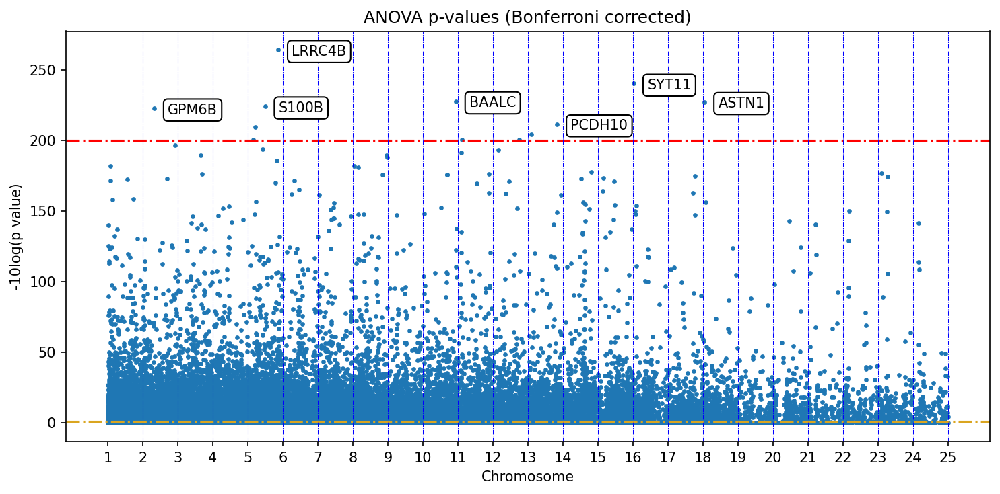

In [182]:
x_labels = [1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13,
            14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25]
# x_labels_pos defined above
# v_divs defined above

plt.rcParams["figure.figsize"] = [10.00, 5]
# plt.rcParams["figure.dpi"] = 150

ax = plt.subplot()
# ax.figure(figsize=(10,5))
ax.scatter(x=anova_chrom_df['Gene start (bp)'], y=anova_chrom_df['bonf'], s=5)
ax.set_ylabel('-10log(p value)')
ax.set_xlabel('Chromosome')
ax.axhline(y=-(math.log10(.05)), color='goldenrod', linestyle='dashdot')
ax.axhline(y=200, color='red', linestyle='dashdot')

for divider in v_divs:
    ax.axvline(x=divider, color='blue', linestyle='dashdot', linewidth=.5)

ax.set_xticks(x_labels_pos)
ax.set_xticklabels(x_labels)

for gene in top_genes['Gene name']:
    print(gene)
    x = top_genes[top_genes['Gene name'] == gene]['Gene start (bp)'].values
    y = top_genes[top_genes['Gene name'] == gene]['bonf'].values
    ax.annotate(gene, xy=(x,y), xytext=(x+.4e7,y-4), bbox=dict(boxstyle="round", fc="w"))




ax.set_title('ANOVA p-values (Bonferroni corrected)')

In [105]:
# I realized what I have done wrong -- I need to adjust ALL of the bp values based on the chromosome end indices

adjusted_start = list()

for row in anova_num_chrom_df.iterrows():
#     print(v_divs[int(row[1]['Chromosome/scaffold name'])-1])
    new_start = v_divs[int(row[1]['Chromosome/scaffold name'])-1] - row[1]['Gene start (bp)']
    adjusted_start.append(new_start)

In [106]:
anova_num_chrom_df['adjusted_start'] = adjusted_start

In [107]:
anova_num_chrom_df

,Chromosome/scaffold name,Gene start (bp),Gene name,statistic,pvalue,bonf,adjusted_start
ENSG00000206704.1,1,28985710,Y_RNA,30.170504,2.314229e-13,8.110964,219936467
ENSG00000206659.1,1,175022479,Y_RNA,0.703980,4.949169e-01,-0.000000,73899698
ENSG00000206654.1,1,39120940,RNU6-608P,56.570841,1.023034e-23,18.465480,209801237
ENSG00000206652.1,1,16514122,RNU1-1,27.988804,1.770681e-12,7.227230,232408055
ENSG00000206651.1,1,156484098,Y_RNA,20.510240,2.050102e-09,4.163595,92438079
...,...,...,...,...,...,...,...
ENSG00000224482.1,24,20808776,HSFY4P,3.291763,3.768882e-02,-0.000000,2988765368
ENSG00000129845.5,24,9753156,TTTY1,5.170894,5.869408e-03,-0.000000,2999820988
ENSG00000224408.1,24,9183694,USP9YP22,17.826730,2.656420e-08,3.051074,3000390450
ENSG00000232226.2,24,12252321,ARSFP1,9.127322,1.203031e-04,-0.000000,2997321823


In [183]:
adjusted_x_labels_pos = list()
for x in range(len(x_labels_pos)):
#     print(x)
    new_pos = v_divs[x] - x_label_pos[x]
    adjusted_x_labels_pos.append(new_pos)

IndexError: index 24 is out of bounds for axis 0 with size 24

In [109]:
v_divs

[248922177,
 491058544,
 689274993,
 879421624,
 1060749500,
 1231399894,
 1390495476,
 1535392667,
 1673700431,
 1807431789,
 1942417790,
 2075643935,
 2171794805,
 2260331330,
 2342421240,
 2432580921,
 2515743719,
 2595889848,
 2654402400,
 2718605337,
 2759796950,
 2799798975,
 2955503649,
 3009574144,
 3009589523]

In [110]:
x_label_pos

[124461088.5,
 369990360.5,
 590166768.5,
 784348308.5,
 970085562.0,
 1146074697.0,
 1310947685.0,
 1462944071.5,
 1604546549.0,
 1740566110.0,
 1874924789.5,
 2009030862.5,
 2123719370.0,
 2216063067.5,
 2301376285.0,
 2387501080.5,
 2474162320.0,
 2555816783.5,
 2625146124.0,
 2686503868.5,
 2739201143.5,
 2779797962.5,
 2877651312.0,
 2982538896.5,
 3009581833.5]

In [111]:
v_divs[0] - x_label_pos[0]

124461088.5

In [112]:
x_labels_pos

[0.0,
 10372357.541666666,
 20744715.083333332,
 31117072.625,
 41489430.166666664,
 51861787.70833333,
 62234145.25,
 72606502.79166666,
 82978860.33333333,
 93351217.875,
 103723575.41666666,
 114095932.95833333,
 124468290.5,
 134840648.04166666,
 145213005.5833333,
 155585363.125,
 165957720.66666666,
 176330078.2083333,
 186702435.75,
 197074793.29166666,
 207447150.8333333,
 217819508.375,
 228191865.91666666,
 238564223.4583333,
 248936581.0]

In [113]:
adjusted_x_labels_pos

[124461088.5,
 121068183.5,
 99108224.5,
 95073315.5,
 90663938.0,
 85325197.0,
 79547791.0,
 72448595.5,
 69153882.0,
 66865679.0,
 67493000.5,
 66613072.5,
 48075435.0,
 44268262.5,
 41044955.0,
 45079840.5,
 41581399.0,
 40073064.5,
 29256276.0,
 32101468.5,
 20595806.5,
 20001012.5,
 77852337.0,
 27035247.5,
 7689.5]

In [114]:
adjusted_x_labels_pos[::-1]

[7689.5,
 27035247.5,
 77852337.0,
 20001012.5,
 20595806.5,
 32101468.5,
 29256276.0,
 40073064.5,
 41581399.0,
 45079840.5,
 41044955.0,
 44268262.5,
 48075435.0,
 66613072.5,
 67493000.5,
 66865679.0,
 69153882.0,
 72448595.5,
 79547791.0,
 85325197.0,
 90663938.0,
 95073315.5,
 99108224.5,
 121068183.5,
 124461088.5]

In [115]:
top_genes = anova_num_chrom_df[anova_num_chrom_df['bonf'] > 210]
top_genes

,Chromosome/scaffold name,Gene start (bp),Gene name,statistic,pvalue,bonf,adjusted_start
ENSG00000152092.16,1,176857302,ASTN1,1110.981003,2.235641e-232,227.125968,72064875
ENSG00000132718.9,1,155859567,SYT11,1227.423466,2.403618e-245,240.094505,93062610
ENSG00000131409.13,19,50516892,LRRC4B,1465.134217,3.634790e-269,263.914891,2603885508
ENSG00000160307.10,21,46598604,S100B,1084.229710,2.948345e-229,224.005792,2713198346
ENSG00000138650.9,4,133149294,PCDH10,980.273815,1.418884e-216,211.323423,746272330
ENSG00000164929.17,8,103140713,BAALC,1115.368688,6.964762e-233,227.632464,1432251954
ENSG00000046653.15,23,13770939,GPM6B,1071.829669,8.609178e-228,222.540409,2941732710


Text(0.5, 1.0, 'ANOVA p-values (Bonferroni corrected)')

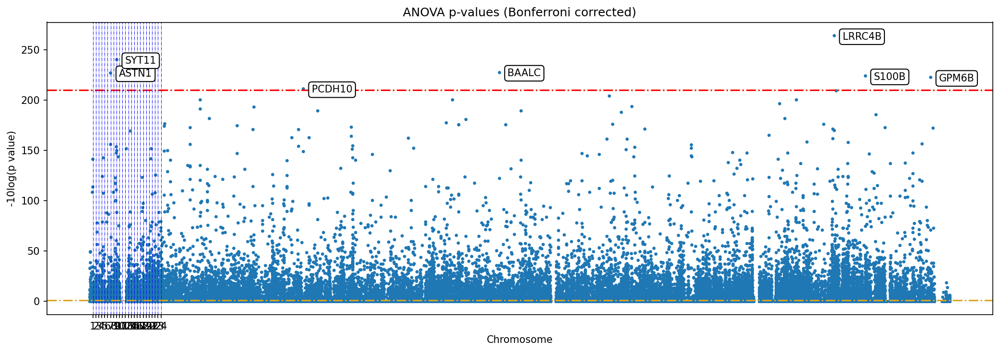

In [185]:
x_labels = [1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13,
            14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24]
# x_labels_pos defined above
# v_divs defined above

plt.rcParams["figure.figsize"] = [14.00, 5]
# plt.rcParams["figure.dpi"] = 150

ax = plt.subplot()
# ax.figure(figsize=(10,5))
ax.scatter(x=anova_num_chrom_df['adjusted_start'], y=anova_num_chrom_df['bonf'], s=5)
ax.set_ylabel('-10log(p value)')
ax.set_xlabel('Chromosome')
ax.axhline(y=-(math.log10(.05)), color='goldenrod', linestyle='dashdot')
ax.axhline(y=210, color='red', linestyle='dashdot')

for divider in v_divs:
    ax.axvline(x=divider, color='blue', linestyle='dashdot', linewidth=.5)

ax.set_xticks(v_divs)
ax.set_xticklabels(x_labels)

for gene in top_genes['Gene name']:
    x = top_genes[top_genes['Gene name'] == gene]['adjusted_start'].values
    y = top_genes[top_genes['Gene name'] == gene]['bonf'].values
    ax.annotate(gene, xy=(x,y), xytext=(x+3e7,y-4), bbox=dict(boxstyle="round", fc="w"))

ax.set_title('ANOVA p-values (Bonferroni corrected)')

[Text(248922177, 0, '1'),
 Text(491058544, 0, '2'),
 Text(689274993, 0, '3'),
 Text(879421624, 0, '4'),
 Text(1060749500, 0, '5'),
 Text(1231399894, 0, '6'),
 Text(1390495476, 0, '7'),
 Text(1535392667, 0, '8'),
 Text(1673700431, 0, '9'),
 Text(1807431789, 0, '10'),
 Text(1942417790, 0, '11'),
 Text(2075643935, 0, '12'),
 Text(2171794805, 0, '13'),
 Text(2260331330, 0, '14'),
 Text(2342421240, 0, '15'),
 Text(2432580921, 0, '16'),
 Text(2515743719, 0, '17'),
 Text(2595889848, 0, '18'),
 Text(2654402400, 0, '19'),
 Text(2718605337, 0, '20'),
 Text(2759796950, 0, '21'),
 Text(2799798975, 0, '22'),
 Text(2955503649, 0, '23'),
 Text(3009574144, 0, '24'),
 Text(3009589523, 0, '25')]

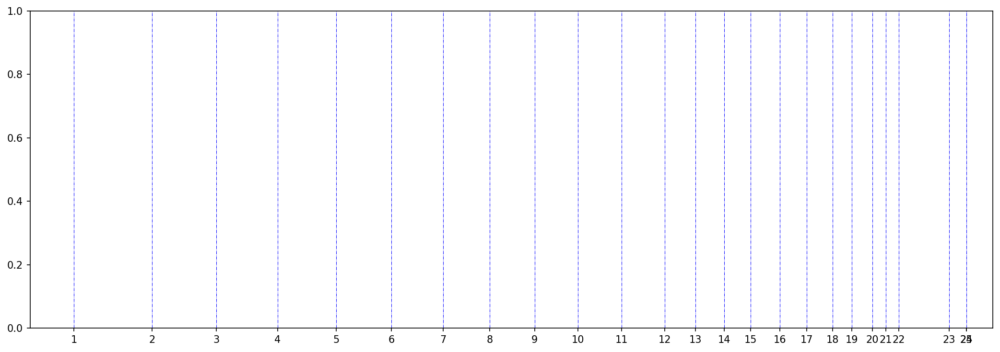

In [117]:
ax = plt.subplot()
for divider in v_divs:
    ax.axvline(x=divider, color='blue', linestyle='dashdot', linewidth=.5)

ax.set_xticks(v_divs)
ax.set_xticklabels(x_labels)

# All sig genes for GO analysis

1.3010299956639813

In [153]:
len(anova_num_chrom_df[anova_num_chrom_df['bonf'] > -math.log10(.05)])

19627

In [157]:
all_sig_genes = list(anova_num_chrom_df[anova_num_chrom_df['bonf'] > -math.log10(.05)]['Gene name'])

In [186]:
all_sig_genes[:10]

['Y_RNA',
 'RNU6-608P',
 'RNU1-1',
 'Y_RNA',
 'RNU6-969P',
 'ZNF670',
 'RNU6-877P',
 'DDX59-AS1',
 'RN7SL473P',
 'CZIB']

In [162]:
with open('all_sig_genes.txt', 'w') as out_file:
    for gene in all_sig_genes:
        out_file.write(str(gene + ','))

In [163]:
anova_num_chrom_df

,Chromosome/scaffold name,Gene start (bp),Gene name,statistic,pvalue,bonf,adjusted_start
ENSG00000206704.1,1,28985710,Y_RNA,30.170504,2.314229e-13,8.110964,219936467
ENSG00000206659.1,1,175022479,Y_RNA,0.703980,4.949169e-01,-0.000000,73899698
ENSG00000206654.1,1,39120940,RNU6-608P,56.570841,1.023034e-23,18.465480,209801237
ENSG00000206652.1,1,16514122,RNU1-1,27.988804,1.770681e-12,7.227230,232408055
ENSG00000206651.1,1,156484098,Y_RNA,20.510240,2.050102e-09,4.163595,92438079
...,...,...,...,...,...,...,...
ENSG00000224482.1,24,20808776,HSFY4P,3.291763,3.768882e-02,-0.000000,2988765368
ENSG00000129845.5,24,9753156,TTTY1,5.170894,5.869408e-03,-0.000000,2999820988
ENSG00000224408.1,24,9183694,USP9YP22,17.826730,2.656420e-08,3.051074,3000390450
ENSG00000232226.2,24,12252321,ARSFP1,9.127322,1.203031e-04,-0.000000,2997321823


In [ ]:
Gene stable ID version

In [165]:
anova_num_chrom_df.index

Index(['ENSG00000206704.1', 'ENSG00000206659.1', 'ENSG00000206654.1',
       'ENSG00000206652.1', 'ENSG00000206651.1', 'ENSG00000206640.1',
       'ENSG00000162377.6', 'ENSG00000206637.1', 'ENSG00000206635.1',
       'ENSG00000206627.1',
       ...
       'ENSG00000251970.1', 'ENSG00000224634.1', 'ENSG00000129862.7',
       'ENSG00000231988.1', 'ENSG00000224485.1', 'ENSG00000224482.1',
       'ENSG00000129845.5', 'ENSG00000224408.1', 'ENSG00000232226.2',
       'ENSG00000223856.1'],
      dtype='object', length=33468)

In [166]:
sig_genes_index = list(anova_num_chrom_df[anova_num_chrom_df['bonf'] > -math.log10(.05)].index)

In [170]:
sig_genes_index[:10]

['ENSG00000206704.1',
 'ENSG00000206654.1',
 'ENSG00000206652.1',
 'ENSG00000206651.1',
 'ENSG00000206627.1',
 'ENSG00000277462.2',
 'ENSG00000206595.1',
 'ENSG00000260088.1',
 'ENSG00000277452.1',
 'ENSG00000162384.14']

In [169]:
with open('sig_genes_index.txt', 'w') as out_file:
    for gene in sig_genes_index:
        out_file.write(str(gene + '\n'))

# Code that was ultimately not used in the analysis, shown below

In [118]:
# here's an example of a manhattan plot with plotly

import pandas as pd
import dash_bio


plotly_df = pd.read_csv('https://raw.githubusercontent.com/plotly/dash-bio-docs-files/master/manhattan_data.csv')

dash_bio.ManhattanPlot(
    dataframe=plotly_df,
    highlight_color='#00FFAA',
    suggestiveline_color='#AA00AA',
    genomewideline_color='#AA5500'
)

In [119]:
# I'll re-configure my df to match the columns in https://raw.githubusercontent.com/plotly/dash-bio-docs-files/master/manhattan_data.csv

# CHR,BP,P,SNP,ZSCORE,EFFECTSIZE,GENE,DISTANCE

anova_chrom_df


,Chromosome/scaffold name,Gene start (bp),Gene name,statistic,pvalue,bonf
ENSG00000206704.1,1,28985710,Y_RNA,30.170504,2.314229e-13,8.110964
ENSG00000206659.1,1,175022479,Y_RNA,0.703980,4.949169e-01,-0.000000
ENSG00000206654.1,1,39120940,RNU6-608P,56.570841,1.023034e-23,18.465480
ENSG00000206652.1,1,16514122,RNU1-1,27.988804,1.770681e-12,7.227230
ENSG00000206651.1,1,156484098,Y_RNA,20.510240,2.050102e-09,4.163595
...,...,...,...,...,...,...
ENSG00000224482.1,Y,20808776,HSFY4P,3.291763,3.768882e-02,-0.000000
ENSG00000129845.5,Y,9753156,TTTY1,5.170894,5.869408e-03,-0.000000
ENSG00000224408.1,Y,9183694,USP9YP22,17.826730,2.656420e-08,3.051074
ENSG00000232226.2,Y,12252321,ARSFP1,9.127322,1.203031e-04,-0.000000


In [120]:
plotly_style_df = pd.DataFrame({'CHR': anova_chrom_df['Chromosome/scaffold name'], 
                                'BP': anova_chrom_df['Gene start (bp)'], 
                                'P': anova_chrom_df['pvalue'], 
                                'SNP': anova_chrom_df['Gene name'], 
                                'ZSCORE': anova_chrom_df['pvalue'], 
                                'EFFECTSIZE': anova_chrom_df['statistic'],
                                'GENE': anova_chrom_df['Gene name'],
                                'DISTANCE': anova_chrom_df['statistic']})

In [121]:
# ok I couldn't get plotly to work nvm

In [122]:
plotly_style_df = plotly_style_df.sort_values('CHR')

In [123]:
plotly_style_df['CHR'].unique()

array(['1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19',
       '2', '20', '21', '22', '3', '4', '5', '6', '7', '8', '9', 'MT',
       'X', 'Y'], dtype=object)

In [124]:
plotly_df_grouped = plotly_style_df.groupby(('CHR'))

In [189]:
# for group in plotly_df_grouped:
#     print(group)

In [188]:
# for num, (name, group) in enumerate(plotly_df_grouped):
#     print(num)
#     print(name)
#     print(group)

In [187]:
# # manhattan plot
# fig = plt.figure(figsize=(14, 8)) # Set the figure size
# ax = fig.add_subplot(111)
# colors = ['darkred','darkgreen','darkblue', 'gold']
# mpl_x_labels = []
# mpl_x_labels_pos = []
# for num, (name, group) in enumerate(mpl_df_grouped):
#     group.plot(kind='scatter', x='ind', y='minuslog10pvalue',color=colors[num % len(colors)], ax=ax)
#     x_labels.append(name)
#     x_labels_pos.append((group['ind'].iloc[-1] - (group['ind'].iloc[-1] - group['ind'].iloc[0])/2))
# ax.set_xticks(mpl_x_labels_pos)
# ax.set_xticklabels(mpl_x_labels)

# # set axis limits
# ax.set_xlim([0, len(mpl_df)])
# ax.set_ylim([0, 300])

# # x axis label
# ax.set_xlabel('Chromosome')

# # show the graph
# plt.show()